In [1]:
import argparse
import os
import random
import shutil
import time
import warnings
import sys
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.distributed as dist
import torch.optim
from torch.autograd import Variable
import torch.multiprocessing as mp
import torch.utils.data
import torch.utils.data.distributed
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models
import torch.optim as optim
from torch.optim import lr_scheduler
import matplotlib.pyplot as plt


from resnet_segmentation import *

In [2]:
torch.cuda.get_device_name(0)
device = 'cuda'

In [3]:
data_dir = "/scratch/cra354/ssl_data_96/unsupervised"
#data_dir = "/scratch/cra354/smaller_set"
model_save_path = 'resnet_reconstruction.pth'

input_shape = 320
batch_size = 8
mean = [0.5, 0.5, 0.5]
std = [0.5, 0.5, 0.5]
scale = 360
use_parallel = True
use_gpu = True
epochs = 2

data_transforms = {
        'train': transforms.Compose([
        transforms.Resize(input_shape),
        #transforms.RandomResizedCrop(input_shape),
        #transforms.RandomHorizontalFlip(),
        #transforms.RandomVerticalFlip(),
        #transforms.RandomRotation(degrees=90),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)]),
        'val': transforms.Compose([
        transforms.Resize(input_shape),
        #transforms.CenterCrop(input_shape),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)]),}

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                      data_transforms[x]) for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=batch_size,
                                shuffle=True, num_workers=4) for x in ['train', 'val']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = image_datasets['train'].classes

In [4]:
class GaussianNoise(nn.Module):
    """Gaussian noise regularizer.

    Args:
        sigma (float, optional): relative standard deviation used to generate the
            noise. Relative means that it will be multiplied by the magnitude of
            the value your are adding the noise to. This means that sigma can be
            the same regardless of the scale of the vector.
        is_relative_detach (bool, optional): whether to detach the variable before
            computing the scale of the noise. If `False` then the scale of the noise
            won't be seen as a constant but something to optimize: this will bias the
            network to generate vectors with smaller values.
    """

    def __init__(self, sigma=0.1, is_relative_detach=True):
        super().__init__()
        self.sigma = sigma
        self.is_relative_detach = is_relative_detach
        self.noise = torch.tensor(0).type(torch.FloatTensor).to(device)

    def forward(self, x):
        if self.training and self.sigma != 0:
            scale = self.sigma * x.detach() if self.is_relative_detach else self.sigma * x
            sampled_noise = self.noise.repeat(*x.size()).normal_() * scale
            x = x + sampled_noise
        return x 

In [5]:
model_conv = nn.Sequential(GaussianNoise(), ResNet18())


criterion = nn.MSELoss()
optimizer_conv = optim.SGD(list(filter(lambda p: p.requires_grad, 
                            model_conv.parameters())), lr=0.001, momentum=0.9)
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_conv, step_size=20, gamma=0.1)
model_conv = model_conv.cuda()

In [ ]:
def train_model(model, dataloaders, dataset_sizes, criterion, optimizer, scheduler, use_gpu=True, num_epochs=25,  alpha = 0.1):
    since = time.time()

    best_model_wts = model.state_dict()
    best_loss = 999.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train(True)  # Set model to training mode
            else:
                model.train(False)  # Set model to evaluate mode

            running_loss = 0.0

            # Iterate over data.
            for data in tqdm(dataloaders[phase]):
                # get the inputs
                inputs, _ = data

                # wrap them in Variable
                if use_gpu:
                    inputs = Variable(inputs.cuda())
                else:
                    inputs= Variable(inputs)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                outputs = model(inputs)
                if type(outputs) == tuple:
                    outputs, _ = outputs
                loss = criterion(outputs, inputs)

                # backward + optimize only if in training phase
                if phase == 'train':
                    loss.backward()
                    optimizer.step()

                # statistics
                #running_loss += loss.data[0]
                running_loss += loss.item()


            epoch_loss = running_loss / dataset_sizes[phase]
            #print('{} Loss: {:.4f}'.format(
                #phase, epoch_loss))

            # deep copy the model
            if phase == 'val' and epoch_loss < best_loss:
                best_loss = epoch_loss
                print("best loss")
                print(best_loss)
                torch.save(model.state_dict(), model_save_path)            

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))

    # load best model weights
    return model

In [ ]:
#model_ft = train_model(model_conv, dataloaders, dataset_sizes, criterion, optimizer_conv, exp_lr_scheduler, use_gpu=True,
#                     num_epochs=epochs)



In [6]:
model_conv.load_state_dict(torch.load(model_save_path))

/home/cra354/pytorch-cpu/py3.6.3/lib/python3.6/site-packages/torch/nn/functional.py:1006: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


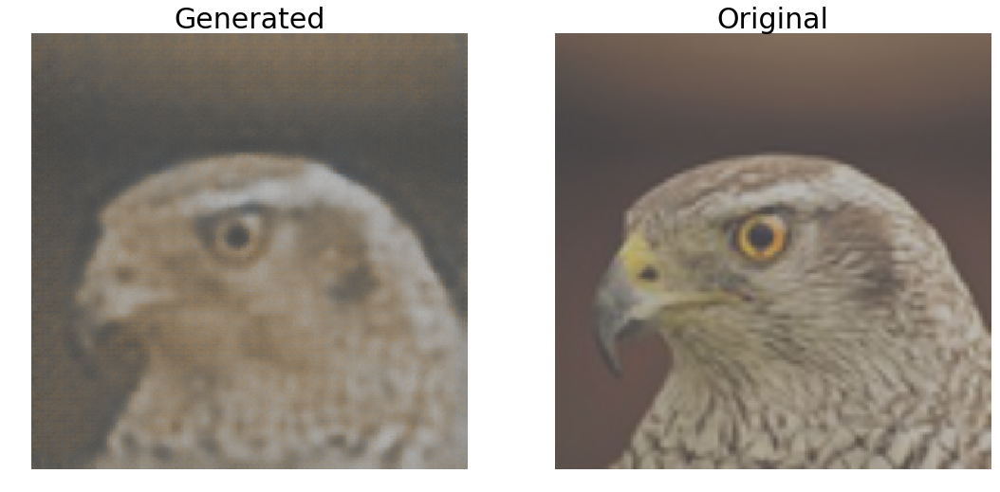

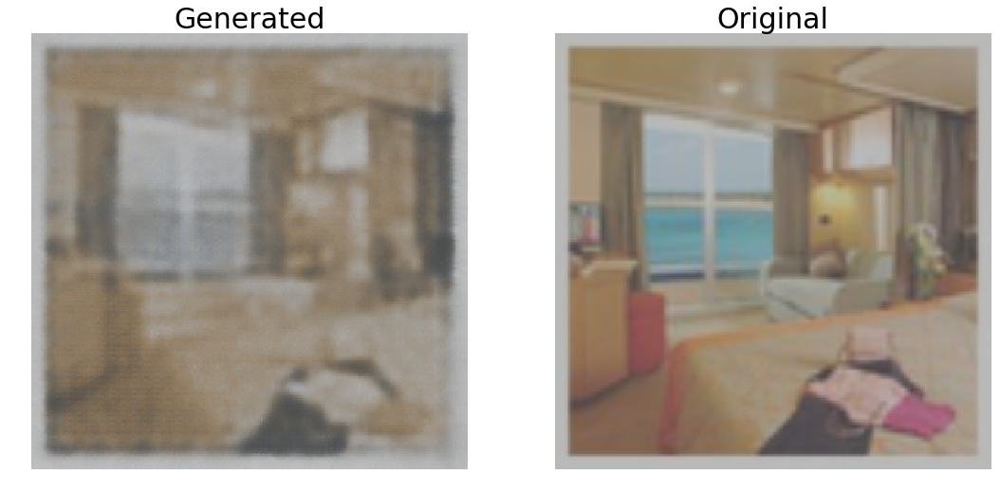

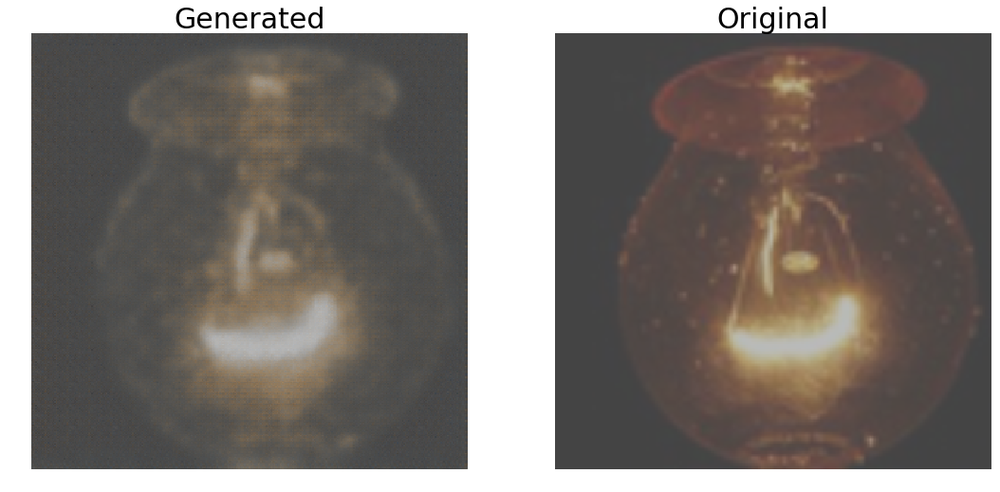

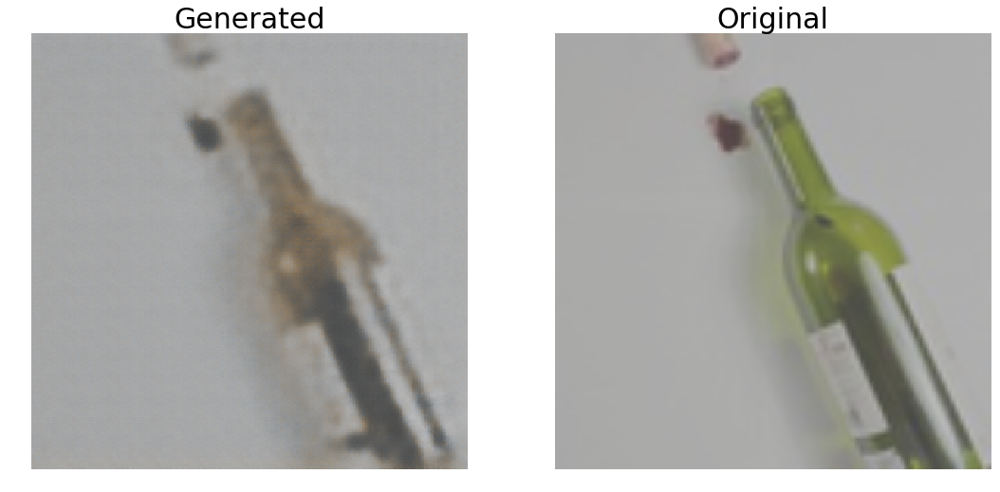

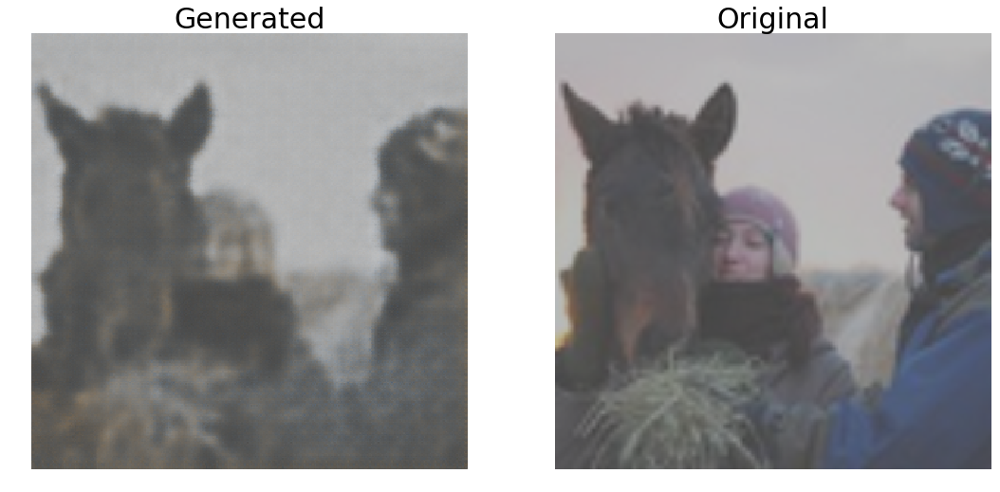

...

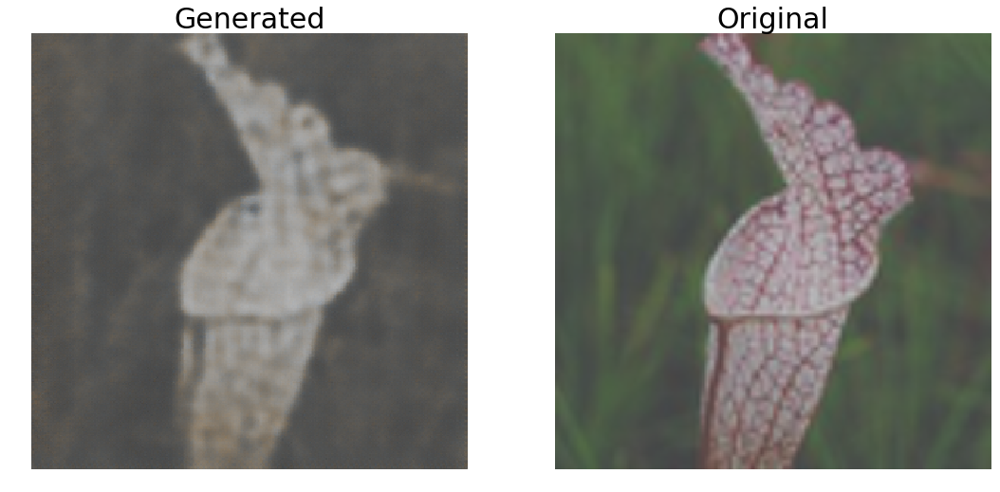

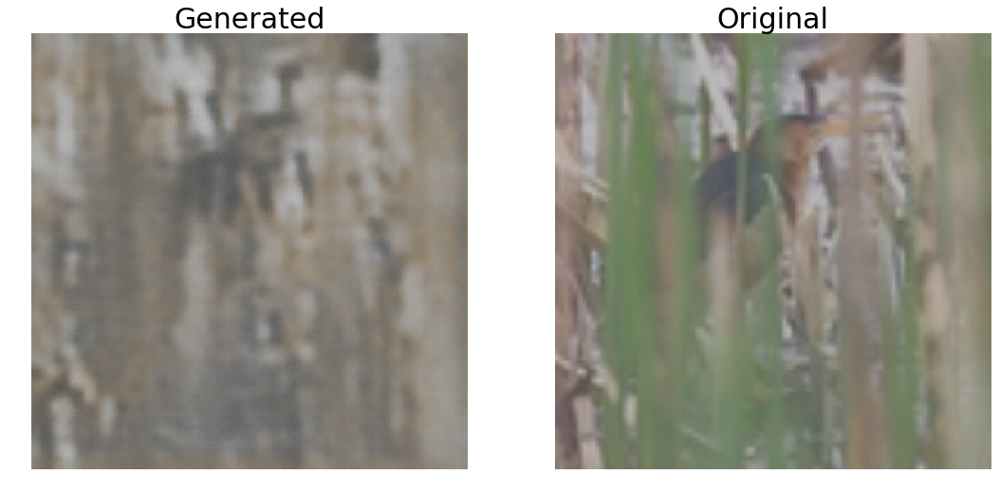

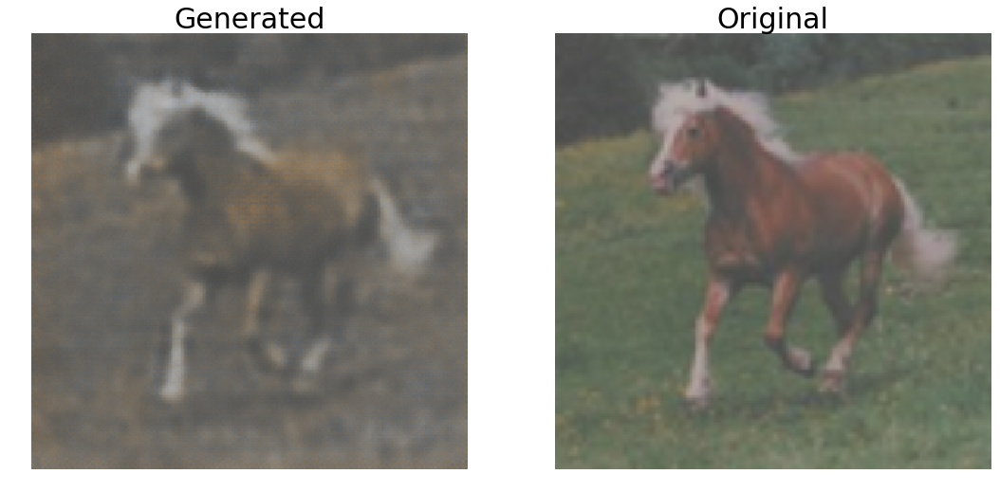

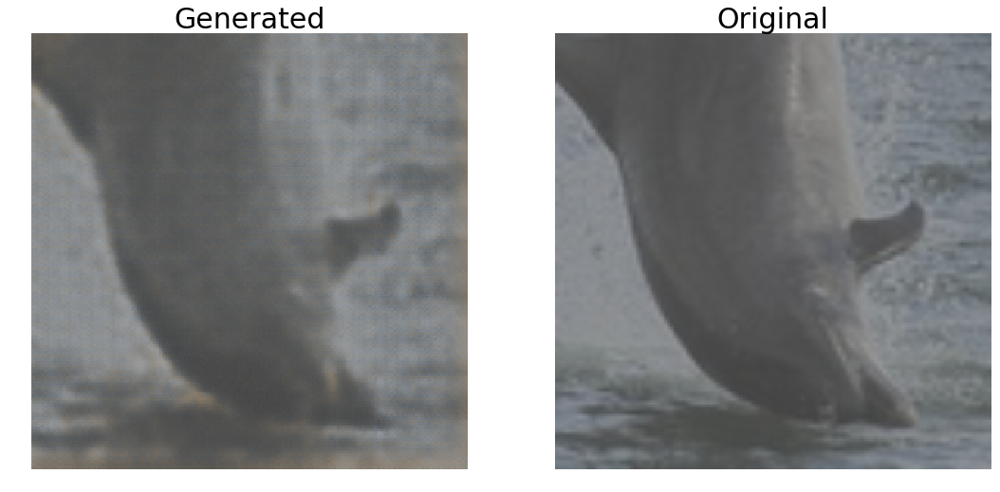

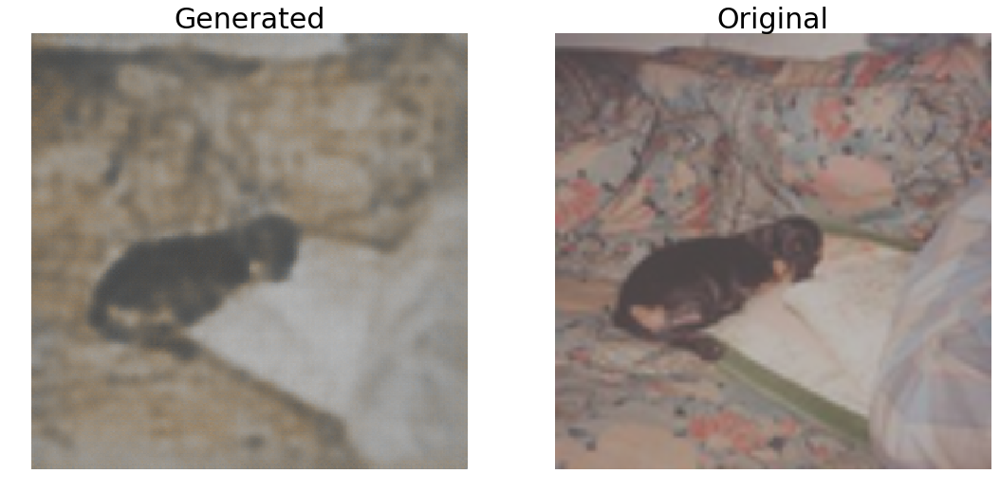

Process Process-4:
Process Process-3:
Process Process-2:
Process Process-1:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/share/apps/python3/3.6.3/intel/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/share/apps/python3/3.6.3/intel/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/share/apps/python3/3.6.3/intel/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/share/apps/python3/3.6.3/intel/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/share/apps/python3/3.6.3/intel/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/share/apps/python3/3.6.3/intel/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File

KeyboardInterrupt: 

In [7]:
model_cpu = model_conv.cpu()
model_cpu.train(False)
for data in dataloaders['val']:
    inputs, _ = data
    decoded_imgs = F.sigmoid(model_conv(inputs).data)
    inputs = F.sigmoid(inputs[0])
    decoded_img = decoded_imgs[0]
    decoded_img = decoded_img.permute(1, 2, 0) 
    inputs = inputs.permute(1, 2, 0)
    plt.figure(figsize=(28, 28))
    plt.subplot(1, 3, 1)
    plt.imshow(decoded_img.detach().numpy().reshape(input_shape,input_shape, 3))
    plt.title('Generated', fontsize=30)
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    #plt.imshow(image.load_img(image_path[image_n], target_size=(size, size)))
    plt.imshow(inputs.detach().numpy().reshape(input_shape, input_shape, 3))
    plt.title('Original', fontsize=30)

    plt.axis('off')
    plt.show()